<a href="https://colab.research.google.com/github/jjAguil/Tareas-Simulacion/blob/main/Numpy_3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Cómputo Numérico - Ecuación de Calor en 2D
Primero que nada, debemos de hablar de la *Ecuación de Calor* y del método de
*diferencias finitas*.

## Ecuación de Calor
Es una **ecuación diferencial**, de la forma:
$$
\frac{\partial u}{\partial t} - \alpha \nabla u = 0
$$

que para un caso bidimensional, es decir, en el plano cartesiano, se
escribe de la siguiente manera:
$$
\frac{\partial u}{\partial t} - \alpha \left( \frac{\partial^2 u}{\partial x^2}  \frac{\partial^2 u}{\partial y^2}  \right) = 0
$$
donde:
- $u$ es la variable para la cual se va a resolver la simulación
- $x$ y $y$ son variables espaciales (el plano cartesiano) y
- $\alpha$ es una constante de difusión

entonces, lo que se busca es **encontrar el valor de $u$ para todas las
coordenadas del plano $xy$, para cierto tiempo $t$**.

## Método de diferencias finitas
Es un método *numérico* para resolver ecuaciones diferenciales, aproximando
los valores de las derivadas con *diferencias finitas*; la definición formal de
una derivada es:

$$
f'(x + h) = \lim_{h \rightarrow 0}\frac{f(x + h) - f(x)}{h}
$$

El método de diferencias finitas utiliza las Series de Taylor para aproximar las
derivadas, lo que en resúmen, quita el *límite* de la ecuación:

$$
f'(x + h) = \frac{f(x + h) - f(x)}{h}
$$

Con este método, vamos a *discretizar* los dominios espacial y temporal, es
decir, a $x$, $y$ y $z$, mediante:

$$
x_i = i Δx
$$

$$
y_j = j Δy
$$

$$
t_k = k Δt
$$

donde $i, j$ y $k$ son los *pasos* en el eje correspondiente.


![](https://yaredwb.github.io/FDM2D/assets/images/2D_grid.png)
![](https://vanhunteradams.com/DE1/Drum/two.png)

Ahora, podemos expresar a $u$ como una función:
$$
u(x, y, t) = u^k_{i, j}
$$
por lo tanto, podemos reescribir los términos de la ecuación de calor
en su forma diferencial, de forma discreta,
quedando:
$$
\frac{u_{i,j}^{k+1} - u_{i,j}{k}}{\Delta t}
- \alpha \left( \frac{u_{i+1,j}^k - 2u_{i,j}^k + u_{i-1,j}^k}{\Delta x^2}
+
 \frac{u_{i,j+1}^k - 2 u_{i,j}^k + u_{i,j-1}^k}{\Delta y^2}
     \right)
$$
donde:
$$
\gamma = \alpha \frac{\Delta t}{\Delta x^2}
$$


Por simplicidad, se suele hacer $\Delta x = \Delta y$. Por tanto, podemos saber, numéricamente, el
valor de $u$ en un punto $(i, j)$ en un tiempo $k + 1$,
a partir de los valores de $u$ en el tiempo $k$, tanto del punto $(i, j)$
como de sus vecinos.

$$
u_{i, j}^{k + 1} = γ(u^k_{i+1, j} + u^k_{i-1, j}
    + u^k_{i, j+1} + u^k_{i, j-1} - 4 u^k_{i, j})
    + u^k_{i, j}
$$


Para nuestro ejemplo, propondremos una placa plana
con 50 m de lado. Dentro de la placa toda la
temperatura es $0°C$ en el instante $t=0$.

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib.animation import FuncAnimation

print("2D heat equation solver")

long_placa = 50
max_iter_t = 750

alpha = 2
delta_x = 1

delta_t = (delta_x ** 2)/(4 * alpha)
gamma = (alpha * delta_t) / (delta_x ** 2)

# Initialize solution: the grid of u(k, i, j)
u = np.empty((max_iter_t, long_placa, long_placa))

# Initial condition everywhere inside the grid
u_inicial = 0

# Boundary conditions
u_sup = 100.0
u_izq = 42.0
u_inf = 0.0
u_der = 10.0

# Set the initial condition
u.fill(u_inicial)

# Set the boundary conditions
u[:, (long_placa - 1):, :] = u_sup
u[:, :, :1] = u_izq
u[:, :1, 1:] = u_inf
u[:, :, (long_placa - 1):] = u_der

def calcular(u):
    for k in range(0, max_iter_t - 1, 1):
        for i in range(1, long_placa - 1, delta_x):
            for j in range(1, long_placa - 1, delta_x):
                u[k + 1, i, j] = gamma * (u[k, i+1, j] + u[k, i-1, j]
                                          + u[k, i, j+1] + u[k, i, j-1]
                                          - 4*u[k, i, j]) + u[k, i, j]
    return u

def plotheatmap(u_k, k):
    # Clear the current plot figure
    plt.clf()

    plt.title(f"Temperatura en t = {k*delta_t:.3f}")
    plt.xlabel("x")
    plt.ylabel("y")

    # This is to plot u_k (u at time-step k)
    plt.pcolormesh(u_k, cmap=plt.cm.inferno, vmin=0, vmax=100)
    plt.colorbar()

    return plt

# Do the calculation here
u = calcular(u)

def animar(k):
    plotheatmap(u[k], k)

anim = animation.FuncAnimation(plt.figure(), animar, interval=1,
                               frames=max_iter_t, repeat=False)
anim.save("ecuacion_calor_2d.gif")

print("Done!")

# Manipulación de Imágenes


shape de primera imagen: (1080, 892, 3)
shape de segunda imagen: (675, 1200, 3)
shape de tercera imagen: (1364, 2048, 3)
orden de colores: RGB

Tipo de dato de pil_img: <class 'PIL.JpegImagePlugin.JpegImageFile'>
Tipo de dato de img_array: <class 'numpy.ndarray'>


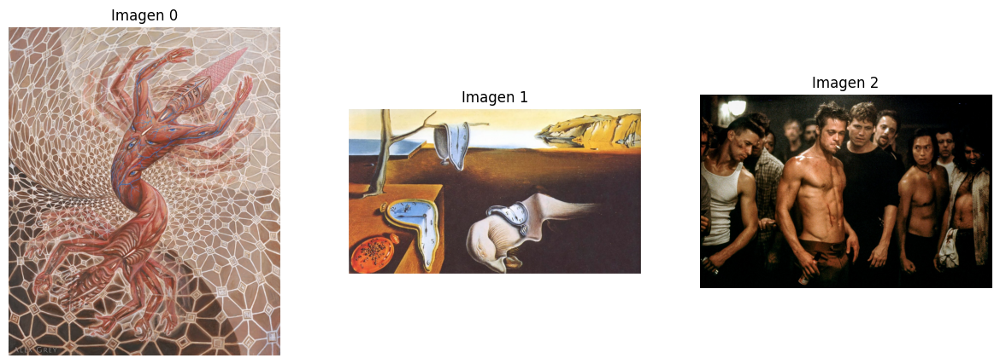

In [ ]:
from PIL import Image
import requests
from io import BytesIO
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

urls = ['https://www.alexgrey.com/art-images/Study-for-the-Great-Turn_2020_Alex-Grey.jpg',
        # 'https://i.imgur.com/bYdyo.jpg',
        'https://i0.wp.com/blog.artsper.com/wp-content/uploads/2021/01/New-Featured-Image-1200-x-675.jpg?fit=1200%2C675&ssl=1',
        'https://hips.hearstapps.com/hmg-prod/images/el-club-de-la-lucha-2-1583853059.jpg?resize=2048:*']
responses = [requests.get(urls[0]), requests.get(urls[1]),
             requests.get(urls[2])]
pil_imgs = [Image.open(BytesIO(responses[0].content)),
            Image.open(BytesIO(responses[1].content)),
            Image.open(BytesIO(responses[2].content))]

# Convert PIL image to NumPy array
imgs_array = [np.array(pil_imgs[0]) / 255.0,
              np.array(pil_imgs[1]) / 255.0,
              np.array(pil_imgs[2]) / 255.0]

print(f"shape de primera imagen: {imgs_array[0].shape}")
print(f"shape de segunda imagen: {imgs_array[1].shape}")
print(f"shape de tercera imagen: {imgs_array[2].shape}")
print(f"orden de colores: {pil_imgs[0].mode}")

print()
print(f"Tipo de dato de pil_img: {type(pil_imgs[0])}")
print(f"Tipo de dato de img_array: {type(imgs_array[0])}")


# Crear subfigura de 1 fila y 3 columnsa
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

for idx, img_array in enumerate(imgs_array):
    axs[idx].imshow(img_array)
    axs[idx].axis('off')
    axs[idx].set_title(f"Imagen {idx}")


## Canales de color
Normalmente, las imágenes tienen 3 dimensiones: ancho, alto y canal de colores.
Dependiendo de la forma de codificar el color, será el número de canales.

Es común, en visión por computadora, utilizar la codificación RGB (rojo, verde,
azul) o BGR. En la siguiente imagen podemos ver la foto de una flor, y como
es descompuesta en 3 canales, donde observamos la cantidad de rojo, verde o
azul que existe en cada punto de la imagen; al combinar los tres canales,
obtenemos la foto original.

![](https://www.numerical-tours.com/matlab/multidim_1_color/index_01.png)

Veamos ahora, cómo están compuestas las imágenes de nuestro ejemplo:

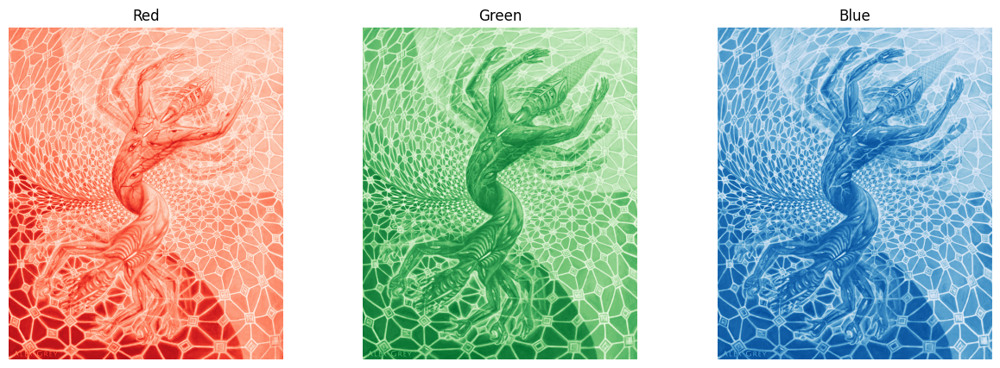

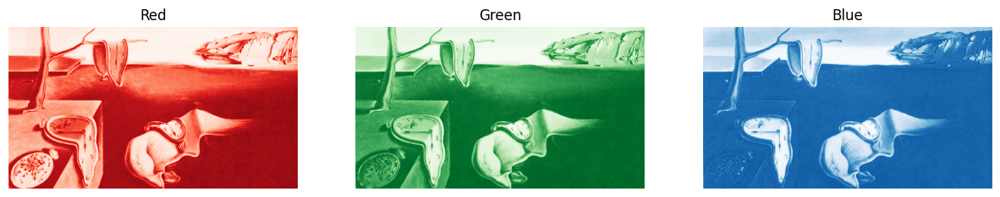

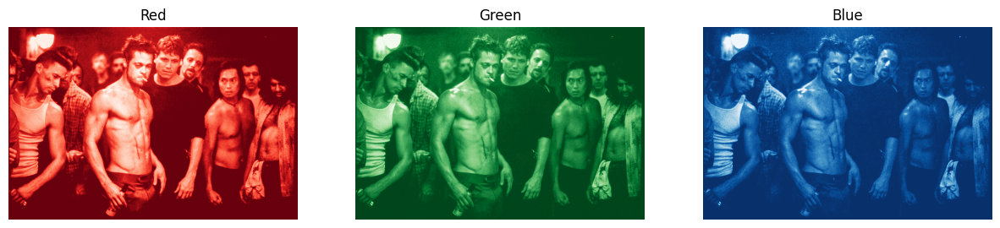

In [ ]:
for img_array in imgs_array:
    # Crear subfigura de 1 fila y 3 columnas
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))

    # Mostrar cada canal de color en cada subfigura
    axs[0].imshow(img_array[..., 0], cmap=plt.cm.Reds_r)
    axs[0].axis('off')
    axs[0].set_title('Red')

    axs[1].imshow(img_array[..., 1], cmap=plt.cm.Greens_r)
    axs[1].axis('off')
    axs[1].set_title('Green')

    axs[2].imshow(img_array[..., 2], cmap=plt.cm.Blues_r)
    axs[2].axis('off')
    axs[2].set_title('Blue')

plt.show()

**NOTA**: recuerda que la computadora solo *ve* números, nosotros somos los que
le damos una interpretación a dichos números, y con base en ello, le decimos a
la computadora cómo manejarlos.

En nuestro ejemplo, nosotros sabemos que la última dimensión del arreglo
`img_array` corresponden a los canales: rojo, verde y azul, en ese orden, y a su
vez, pedimos mostrarlos acorde con dicho código de color. Sin embargo, podemos
visualizar los mismos valores de diferente manera de acuerdo a nuestras
necesidades; solo es importante recordar qué datos estamos visualizando.

Para ejemplificarlo mejor, veremos los mismos tres canales, pero ahora los
visualizaremos con el mismo mapa de colores, aún cuando siguen representando
para nosotros la composición de rojo, verde y azul.

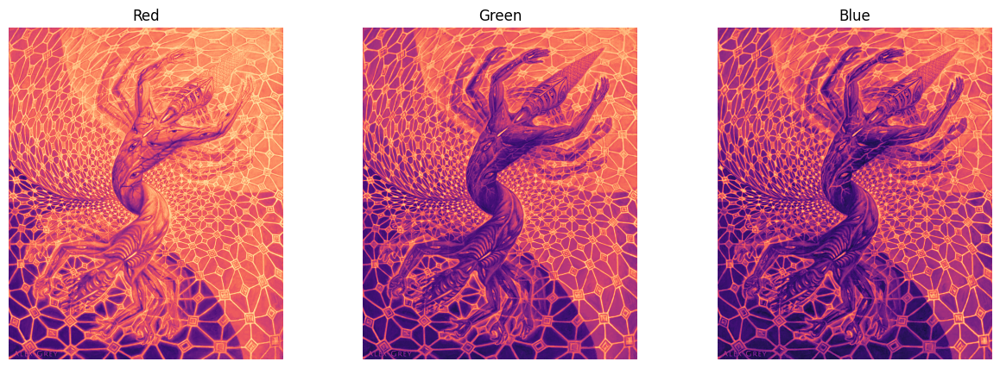

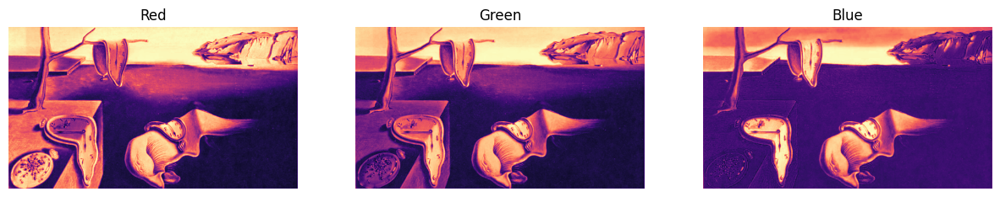

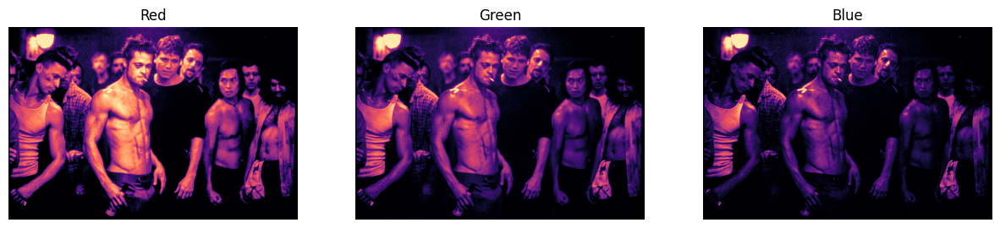

In [ ]:
for img_array in imgs_array:
    # Crear subfigura de 1 fila y 3 columnas
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))

    # Mostrar cada canal de color en cada subfigura
    axs[0].imshow(img_array[..., 0], cmap=plt.cm.magma)
    axs[0].axis('off')
    axs[0].set_title('Red')

    axs[1].imshow(img_array[..., 1], cmap=plt.cm.magma)
    axs[1].axis('off')
    axs[1].set_title('Green')

    axs[2].imshow(img_array[..., 2], cmap=plt.cm.magma)
    axs[2].axis('off')
    axs[2].set_title('Blue')

## Escala de grises
Las imagenes en escala de grises tienen solo un *canal* de color, normalmente se
obtiene mediante un *promedio pesado* de los canales rojo, verde y azul de cada
pixel.

Un método común para convertir una imagen de color a escala de grises es
mediante el método de luminosidad, que asigna diferentes *pesos* a los colores
rojo, verde y azul, basado en la percepción humana del brillo. La formula
utilizada es:

```
pixel_gris = 0.2989 * rojo + 0.5870 * verde + 0.1140 * azul
```

Shape de escala_grises: (1080, 892)
Shape de escala_grises: (675, 1200)
Shape de escala_grises: (1364, 2048)


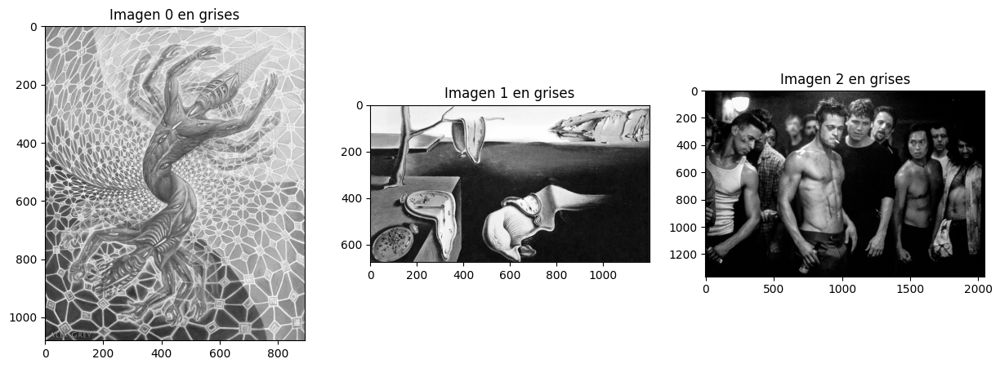

In [ ]:
# Convertir a escala de grises
def grayscale(image):
    return np.dot(image[..., :3], [0.2989, 0.5870, 0.1140])

escalas_grises = []
# Crear subfigura de 1 fila y 3 columnas
fig, axs = plt.subplots(1, 3, figsize=(15, 5))
for idx, img_array in enumerate(imgs_array):
    escalas_grises.append(escala_grises := grayscale(img_array))
    print(f"Shape de escala_grises: {escala_grises.shape}")

    # Mostrar imagen en grises
    axs[idx].imshow(escala_grises, cmap=plt.cm.Greys_r)
    # axs[idx].imshow(escala_grises, cmap=plt.cm.viridis_r)
    axs[idx].set_title(f"Imagen {idx} en grises")


## Reducir el tamaño de la imagen a la mitad

Shape de escala_grises: (1364, 2048)
Shape de escala_grises: (1364, 2048)
Shape de escala_grises: (1364, 2048)


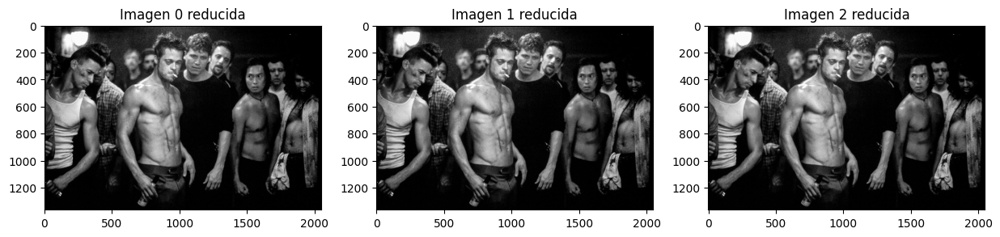

In [ ]:
imgs_array_n = []
for img_array in imgs_array:
    alto, ancho = img_array.shape[0], img_array.shape[1]
    ancho_n, alto_n = ancho // 2, alto // 2
    img_array_n = np.empty((alto_n, ancho_n, 3))
    for canal in range(3):
        for y in range(alto_n):
            for x in range(ancho_n):
                img_array_n[y, x] = img_array[y * 2, x * 2, canal]
    imgs_array_n.append(img_array_n)


# Crear subfigura de 1 fila y 3 columnas
fig, axs = plt.subplots(1, 3, figsize=(15, 5))
for idx, img_array in enumerate(imgs_array_n):
    print(f"Shape de escala_grises: {escala_grises.shape}")

    # Mostrar imagen reducida
    axs[idx].imshow(escala_grises, cmap=plt.cm.Greys_r)
    axs[idx].set_title(f"Imagen {idx} reducida")


## Voltear imagenes

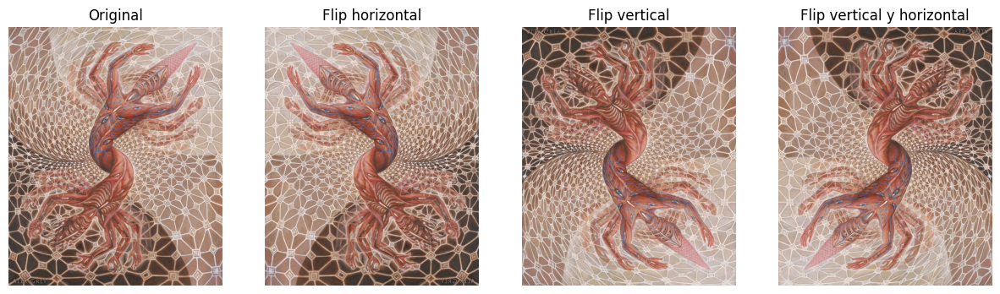

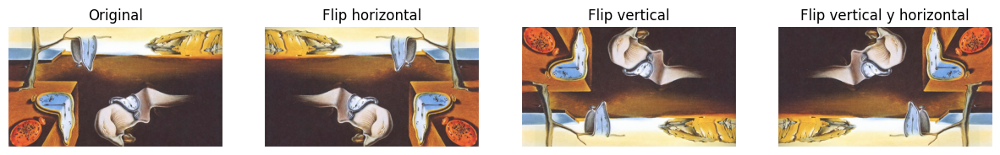

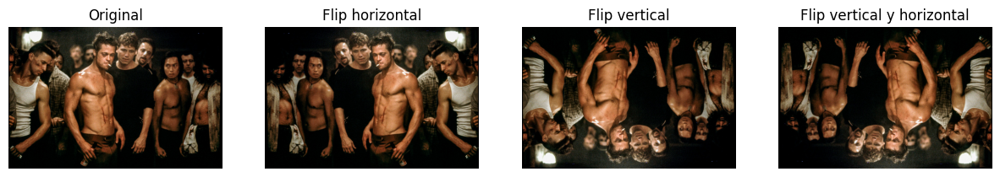

In [ ]:
for img_array in imgs_array:
    # Crear subfigura de 1 fila y 3 columnas
    fig, axs = plt.subplots(1, 4, figsize=(15, 5))

    axs[0].imshow(img_array)
    axs[0].axis('off')
    axs[0].set_title('Original')

    axs[1].imshow(np.flip(img_array, axis=1))
    axs[1].axis('off')
    axs[1].set_title('Flip horizontal')

    axs[2].imshow(np.flip(img_array, axis=0))
    axs[2].axis('off')
    axs[2].set_title('Flip vertical')

    axs[3].imshow(np.flip(img_array, axis=(0, 1)))
    axs[3].axis('off')
    axs[3].set_title('Flip vertical y horizontal')


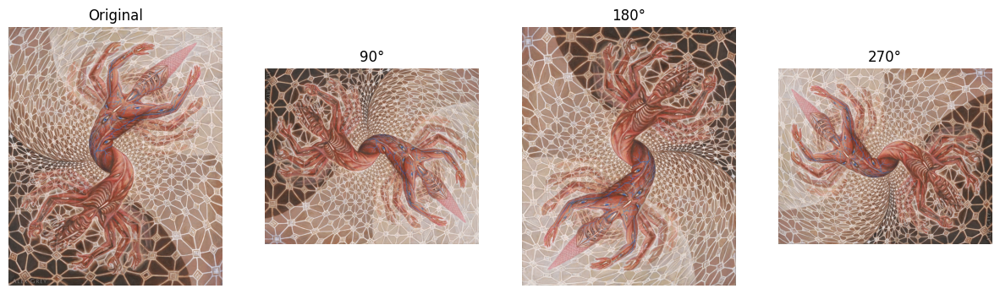

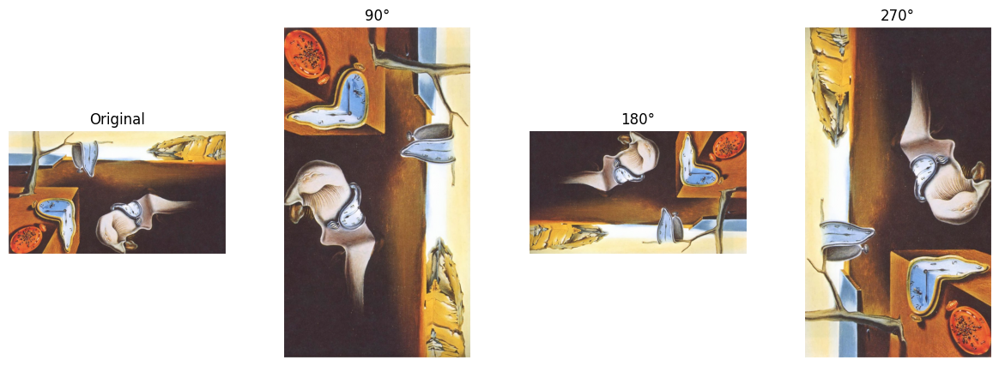

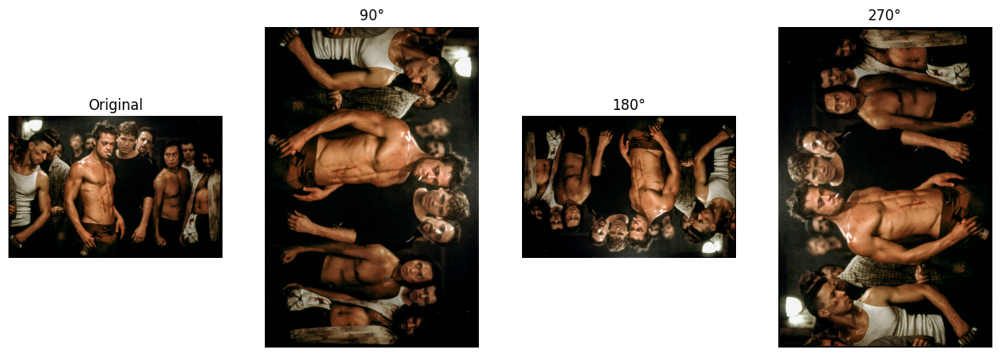

In [ ]:
# Rotar la imagen en sentido horario
def rotar_imagen(image, angle):
    return np.rot90(image, k=-angle // 90)

for img_array in imgs_array:
    # Crear subfigura de 1 fila y 3 columnsa
    fig, axs = plt.subplots(1, 4, figsize=(15, 5))

    # Mostrar rotaciones
    axs[0].imshow(img_array)
    axs[0].axis('off')
    axs[0].set_title('Original')

    axs[1].imshow(rotar_imagen(img_array, 90))
    axs[1].axis('off')
    axs[1].set_title('90°')

    axs[2].imshow(rotar_imagen(img_array, 180))
    axs[2].axis('off')
    axs[2].set_title('180°')

    axs[3].imshow(rotar_imagen(img_array, 270))
    axs[3].axis('off')
    axs[3].set_title('270°')

## Convoluciones - Filtros
![](https://gregorygundersen.com/image/cnns/41847277995.png)

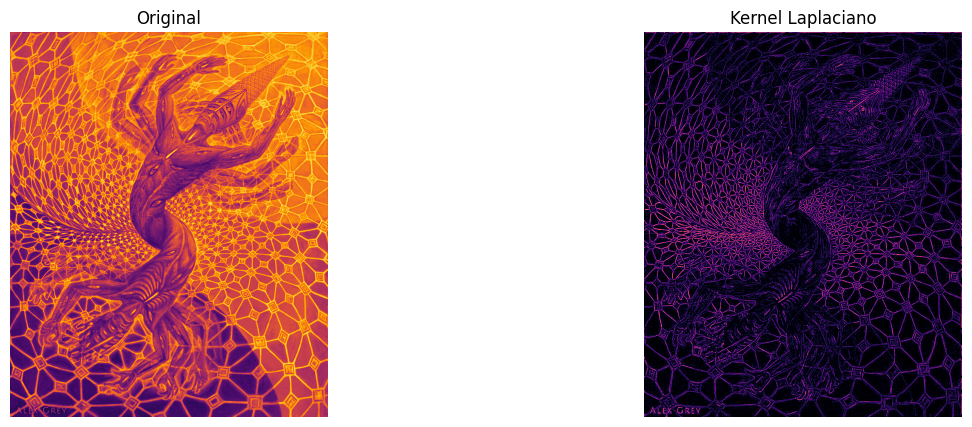

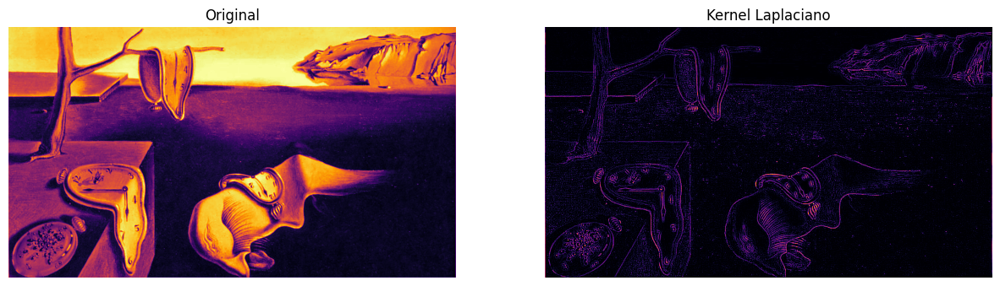

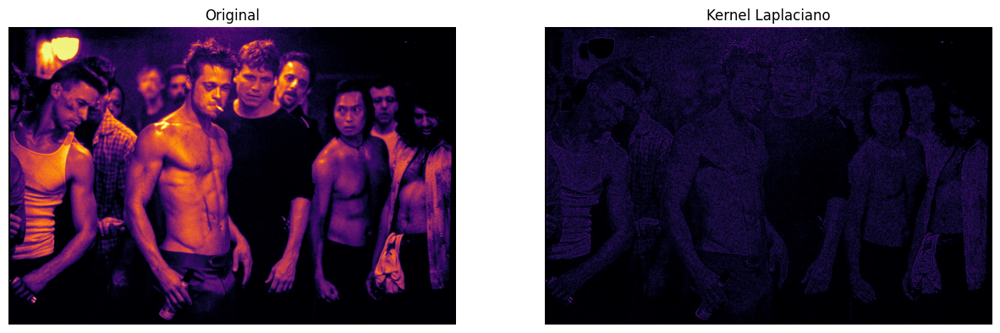

In [ ]:
from scipy.signal import convolve2d
# Aplicar un kernel
def apply_edge_filter(image, kernel):
    filtered_image = convolve2d(image, kernel, mode='same', boundary='wrap')
    filtered_image = np.clip(filtered_image, 0, 1)
    return filtered_image

# Kernel Laplaciano
kernel_laplace = np.array([[-1, -1, -1],
                           [-1,  8, -1],
                           [-1, -1, -1]])

for escala_grises in escalas_grises:
    laplace_img = apply_edge_filter(escala_grises, kernel_laplace)

    # Crear subfigura de 1 fila y 3 columnsa
    fig, axs = plt.subplots(1, 2, figsize=(15, 5))

    # Mostrar kernel laplaciano
    axs[0].imshow(escala_grises, cmap=plt.cm.inferno)
    axs[0].axis('off')
    axs[0].set_title('Original')

    axs[1].imshow(laplace_img, cmap=plt.cm.inferno)
    axs[1].axis('off')
    axs[1].set_title('Kernel Laplaciano')


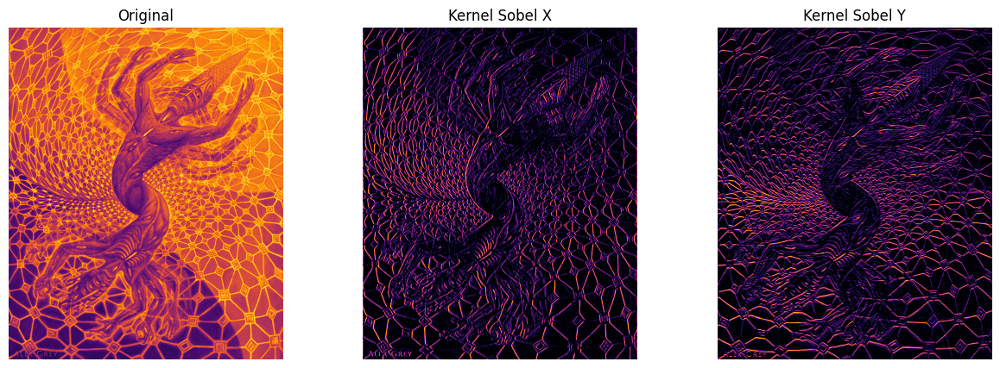

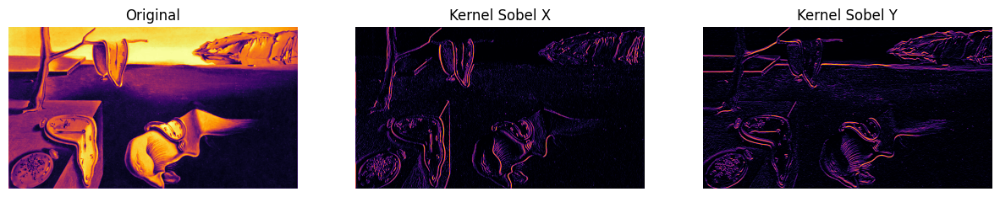

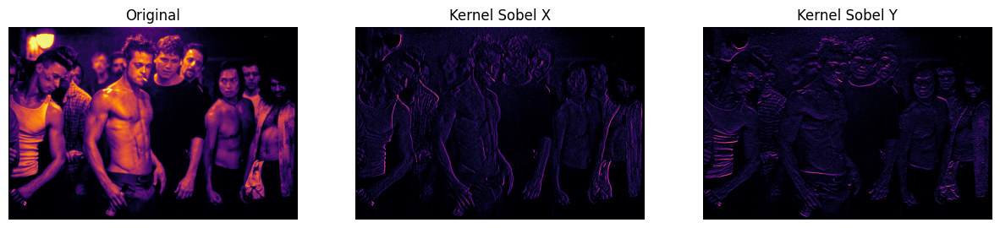

In [ ]:
# Kernels Sobel
kernel_sobel_x = np.array([[-1, 0, 1],
                           [-2, 0, 2],
                           [-1, 0, 1]])

kernel_sobel_y = np.array([[-1, -2, -1],
                           [0, 0, 0],
                           [1, 2, 1]])

for escala_grises in escalas_grises:
    sobel_x_img = apply_edge_filter(escala_grises, kernel_sobel_x)
    sobel_y_img = apply_edge_filter(escala_grises, kernel_sobel_y)

    # graficas de kernels
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))

    axs[0].imshow(escala_grises, cmap=plt.cm.inferno)
    axs[0].axis('off')
    axs[0].set_title('Original')

    axs[1].imshow(sobel_x_img, cmap=plt.cm.inferno)
    axs[1].axis('off')
    axs[1].set_title('Kernel Sobel X')

    axs[2].imshow(sobel_y_img, cmap=plt.cm.inferno)
    axs[2].axis('off')
    axs[2].set_title('Kernel Sobel Y')

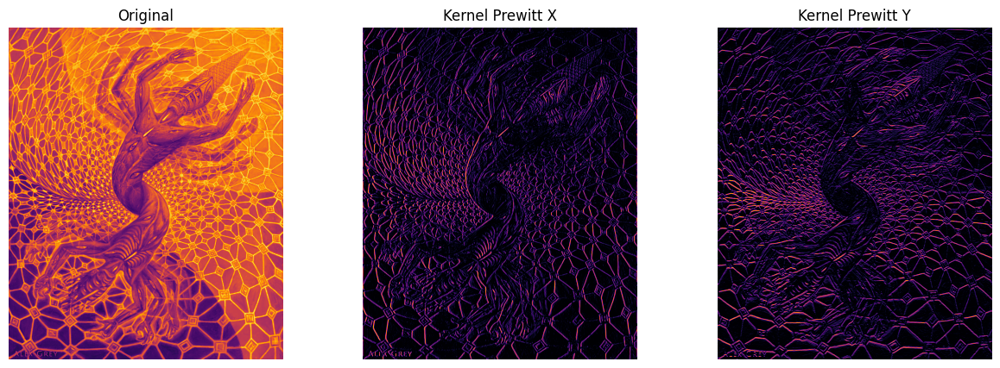

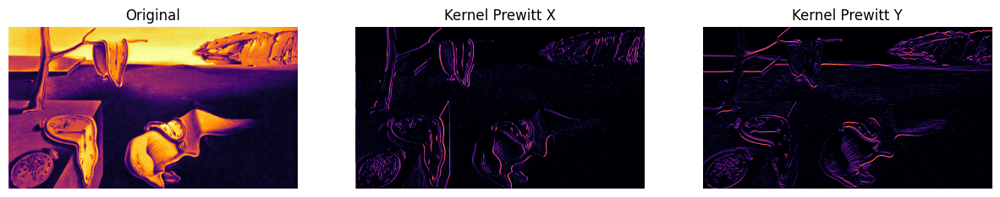

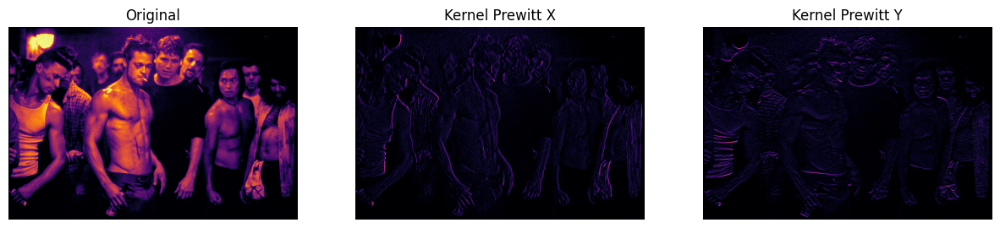

In [ ]:
# Define Prewitt kernels
kernel_prewitt_x = np.array([[-1, 0, 1],
                             [-1, 0, 1],
                             [-1, 0, 1]])

kernel_prewitt_y = np.array([[-1, -1, -1],
                             [0, 0, 0],
                             [1, 1, 1]])


for escala_grises in escalas_grises:
    prewitt_x_img = apply_edge_filter(escala_grises, kernel_prewitt_x)
    prewitt_y_img = apply_edge_filter(escala_grises, kernel_prewitt_y)

    # graficas de kernels
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))

    axs[0].imshow(escala_grises, cmap=plt.cm.inferno)
    axs[0].axis('off')
    axs[0].set_title('Original')

    axs[1].imshow(prewitt_x_img, cmap=plt.cm.inferno)
    axs[1].axis('off')
    axs[1].set_title('Kernel Prewitt X')

    axs[2].imshow(prewitt_y_img, cmap=plt.cm.inferno)
    axs[2].axis('off')
    axs[2].set_title('Kernel Prewitt Y')

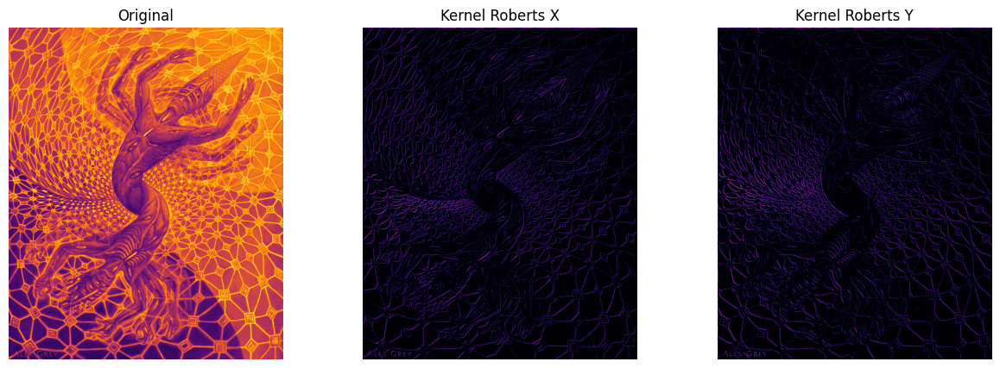

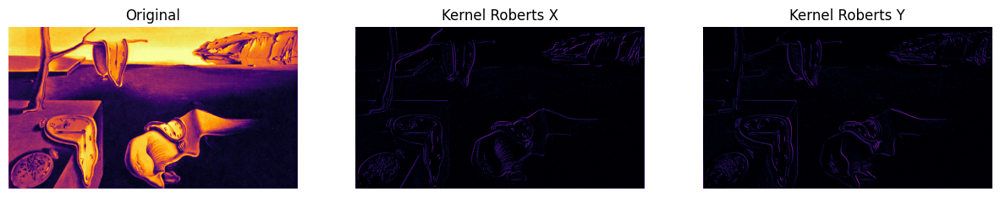

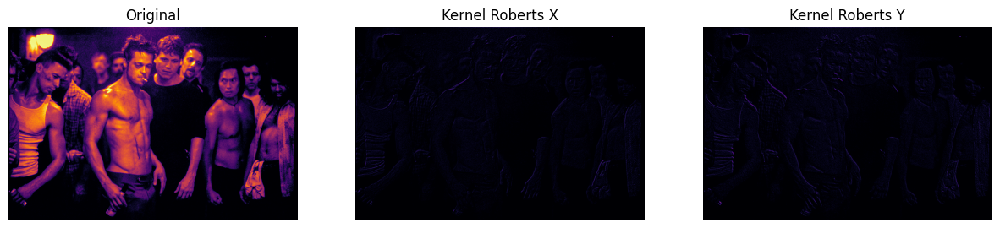

In [ ]:
# Define Roberts kernels
kernel_roberts_x = np.array([[1, 0],
                             [0, -1]])

kernel_roberts_y = np.array([[0, 1],
                             [-1, 0]])

for escala_grises in escalas_grises:
    roberts_x_img = apply_edge_filter(escala_grises, kernel_roberts_x)
    roberts_y_img = apply_edge_filter(escala_grises, kernel_roberts_y)

    # graficas de kernels
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))

    axs[0].imshow(escala_grises, cmap=plt.cm.inferno)
    axs[0].axis('off')
    axs[0].set_title('Original')

    axs[1].imshow(roberts_x_img, cmap=plt.cm.inferno)
    axs[1].axis('off')
    axs[1].set_title('Kernel Roberts X')

    axs[2].imshow(roberts_y_img, cmap=plt.cm.inferno)
    axs[2].axis('off')
    axs[2].set_title('Kernel Roberts Y')

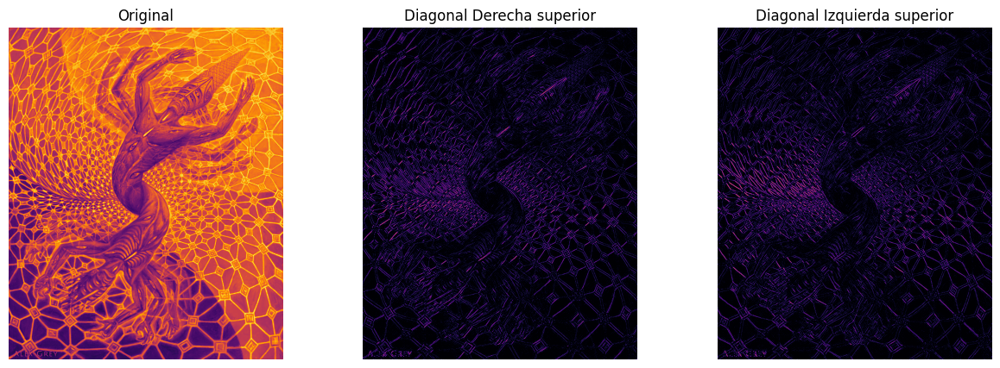

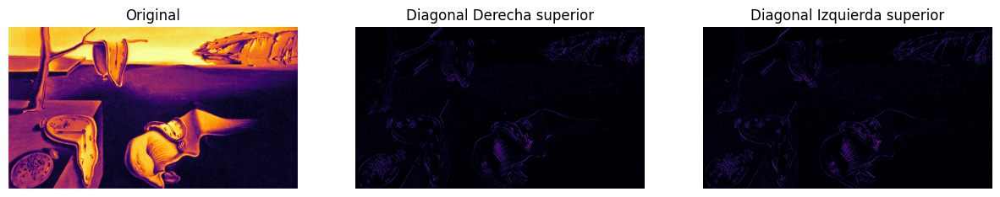

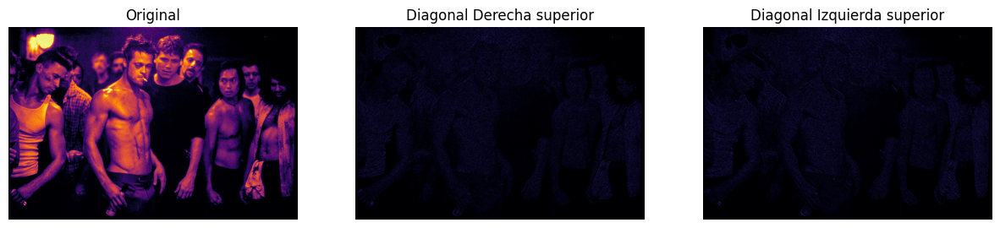

In [ ]:
kernel_izq_sup_der_inf = np.array([[-1, -1,  2],
                                   [-1,  2, -1],
                                   [ 2, -1, -1]])

kernel_der_sup_izq_inf = np.array([[ 2, -1, -1],
                                   [-1,  2, -1],
                                   [-1, -1,  2]])

for escala_grises in escalas_grises:
    diagonal_izq_der_img = apply_edge_filter(escala_grises, kernel_izq_sup_der_inf)
    diagonal_der_izq_img = apply_edge_filter(escala_grises, kernel_der_sup_izq_inf)

    # graficas de kernels
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))

    axs[0].imshow(escala_grises, cmap=plt.cm.inferno)
    axs[0].axis('off')
    axs[0].set_title('Original')

    axs[1].imshow(diagonal_izq_der_img, cmap=plt.cm.inferno)
    axs[1].axis('off')
    axs[1].set_title('Diagonal Derecha superior')

    axs[2].imshow(diagonal_der_izq_img, cmap=plt.cm.inferno)
    axs[2].axis('off')
    axs[2].set_title('Diagonal Izquierda superior')

# Análisis Exploratorio de Datos (EDA)
El análisis exploratorio de datos o *Exploratory Data Analysis*
(EDA), en inglés, es una técnica para analizar datos mediante
técnicas y herramientas visuales.

Esta técnica nos ayuda a obtener información estadística
detallada de nuestros datos, además de observar si tenemos valores
duplicados, *outliers* e incluso si existen tendencias y
correlaciones en nuestros datos.

## Iris Dataset
Considerado el *hello, world* de la Ciencia de Datos y de Machine
Learning.

Se compone de 3 diferentes tipos de Flor Iris: Setosa, Versicolor y Virginica,
con las siguientes características o atributos:
- Longitud de Sépalo
- Ancho de Sépalo
- Longitud de Pétalo
- Ancho de Pétalo

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np
from sklearn import datasets

np.random.seed(42)

# import some data to play with
iris = datasets.load_iris()
X = iris.data  # we only take the first two features.
attrs = iris.feature_names
y = iris.target

In [ ]:
# checar cuantas clases tenemos
classes = np.unique(y)
num_classes = classes.shape[0]
classes_names = iris.target_names
print(f"Número de clases: {num_classes}. Las clases son: {classes}")
print(f"Nombres de Clases: {classes_names}")
print(f"Nombres de Atributos: {attrs}")

Número de clases: 3. Las clases son: [0 1 2]
Nombres de Clases: ['setosa' 'versicolor' 'virginica']
Nombres de Atributos: ['sepal length (cm)', 'sepal width (cm)', 'petal length (cm)', 'petal width (cm)']


In [ ]:
# filtrar qué patrones (vectores) corresponden a qué clase
mask_0 = y == 0
mask_1 = y == 1
mask_2 = y == 2
masks = [mask_0, mask_1, mask_2]

# Obtener mapa de colores
cmap = cm.get_cmap('inferno')
posiciones = [0.10, 0.40, 0.80]

# colores de clases
color_class = [cmap(pos) for pos in posiciones]
hist_color = cmap(0.5)
print(color_class)
print()

print(mask_0)
print(mask_1)
print(mask_2)

[(0.087411, 0.044556, 0.224813, 1.0), (0.578304, 0.148039, 0.404411, 1.0), (0.987622, 0.64532, 0.039886, 1.0)]

[ True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False

<ipython-input-3-1c79b6d820a0>:8: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap('inferno')


### Distribución de Clases

[50, 50, 50]


Total de patrones de la clase Setosa: 50
Total de patrones de la clase Versicolor: 50
Total de patrones de la clase Virginica: 50


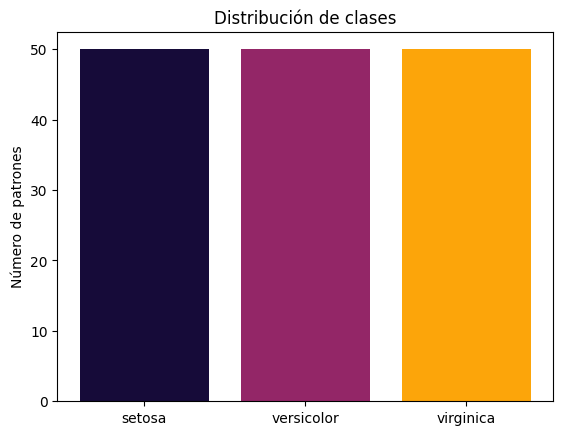

In [ ]:
total_patrones = [np.sum(mask) for mask in masks]
print(total_patrones)
print()
print()

print(f"Total de patrones de la clase Setosa: {total_patrones[0]}")
print(f"Total de patrones de la clase Versicolor: {total_patrones[1]}")
print(f"Total de patrones de la clase Virginica: {total_patrones[2]}")

fig, ax = plt.subplots()
ax.bar(classes_names, total_patrones, color=color_class)

ax.set_ylabel('Número de patrones')
ax.set_title('Distribución de clases')

plt.show()

### Pairplot - comparación entre todos los atributos del dataset

In [ ]:
import matplotlib.pyplot as plt

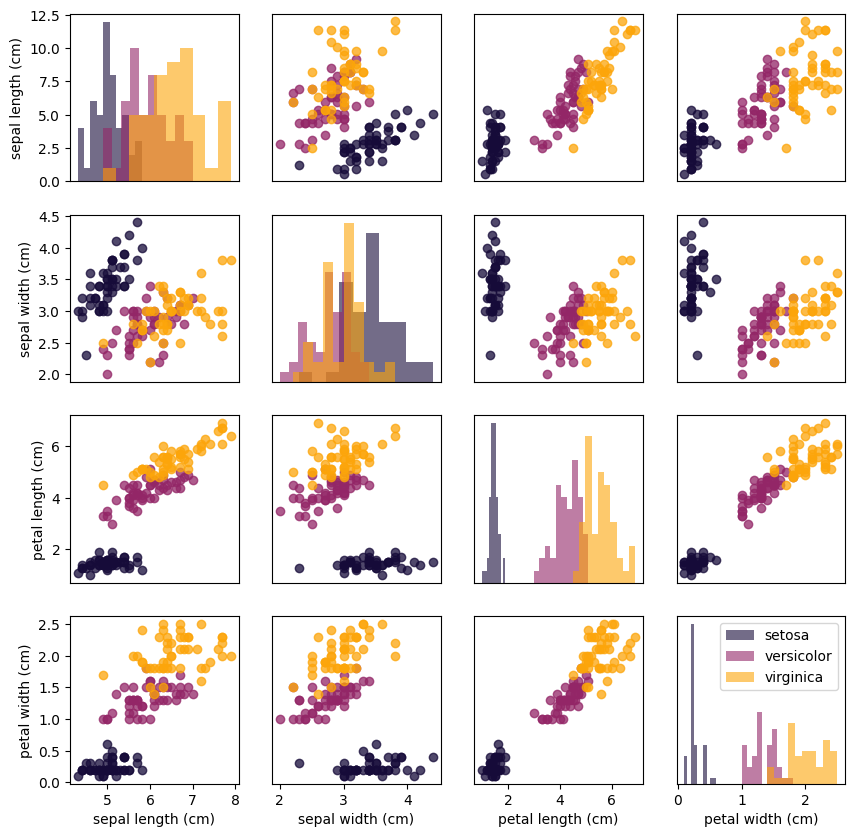

In [ ]:
num_attrs = X.shape[1]

# Crear figura
fig, axes = plt.subplots(nrows=num_attrs, ncols=num_attrs, figsize=(10, 10))


# Crear cada subfigura
for i in range(num_attrs):
    for j in range(num_attrs):
        ax = axes[i, j]

        if i == j:
            # Histograma sobre la diagonal. Mismo atributo
            for clss, mask, color, name in zip(classes, masks, color_class,
                                         classes_names):
                ax.hist(X[mask, i], bins=10, color=color, alpha=0.6,
                        label=f'{name}')
        else:
            # Gráfica de dispersion en comparación de atributos
            for clss, mask, color, name in zip(classes, masks, color_class,
                                         classes_names):
                ax.scatter(X[mask, j], X[mask, i],
                           color=color, alpha=0.75, label=f'{name}')

        # No poner etiquetas a los ejes, excepto en las orillas
        if i < num_attrs - 1:
            ax.set_xticks([])
        if j > 0:
            ax.set_yticks([])

        # Poner etiquetas en las orillas
        if i == num_attrs - 1:
            ax.set_xlabel(f'{attrs[j]}')
        if j == 0:
            ax.set_ylabel(f'{attrs[i]}')
ax.legend()

plt.show()


Mediana sepal length. Setosa: 5.0 Versicolor: 5.9 Virgninica: 6.5
Mediana sepal width. Setosa: 3.4 Versicolor: 2.8 Virgninica: 3.0
Mediana petal length. Setosa: 1.5 Versicolor: 4.35 Virgninica: 5.55
Mediana slepal width. Setosa: 0.2 Versicolor: 1.3 Virgninica: 2.0


<Figure size 1000x600 with 0 Axes>

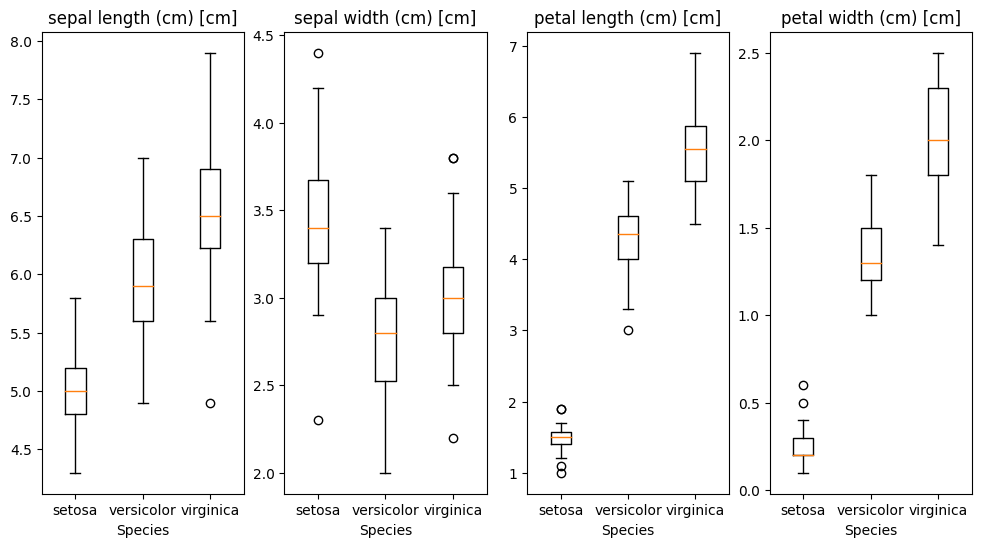

In [ ]:
# Crear gráficas tipo Boxplot
plt.figure(figsize=(10, 6))

fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(12, 6))

for idx, attr in enumerate(attrs):
    axes[idx].boxplot([X[mask_0, idx], X[mask_1, idx], X[mask_2, idx]])
    axes[idx].set_xticks([1, 2, 3], classes_names)
    axes[idx].set_title(f'{attr} [cm]')
    axes[idx].set_xlabel('Species')

sepal_length_median = np.array((np.median(X[mask_0, 0]), np.median(X[mask_1, 0]),
                               np.median(X[mask_2, 0])))

sepal_width_median = np.array((np.median(X[mask_0, 1]), np.median(X[mask_1, 1]),
                               np.median(X[mask_2, 1])))

petal_length_median = np.array((np.median(X[mask_0, 2]), np.median(X[mask_1, 2]),
                               np.median(X[mask_2, 2])))

petal_width_median = np.array((np.median(X[mask_0, 3]), np.median(X[mask_1, 3]),
                               np.median(X[mask_2, 3])))

print(f"Mediana sepal length. Setosa: {sepal_length_median[0]}"
      + f" Versicolor: {sepal_length_median[1]}"
      + f" Virgninica: {sepal_length_median[2]}")

print(f"Mediana sepal width. Setosa: {sepal_width_median[0]}"
      + f" Versicolor: {sepal_width_median[1]}"
      + f" Virgninica: {sepal_width_median[2]}")

print(f"Mediana petal length. Setosa: {petal_length_median[0]}"
      + f" Versicolor: {petal_length_median[1]}"
      + f" Virgninica: {petal_length_median[2]}")

print(f"Mediana slepal width. Setosa: {petal_width_median[0]}"
      + f" Versicolor: {petal_width_median[1]}"
      + f" Virgninica: {petal_width_median[2]}")

plt.show()

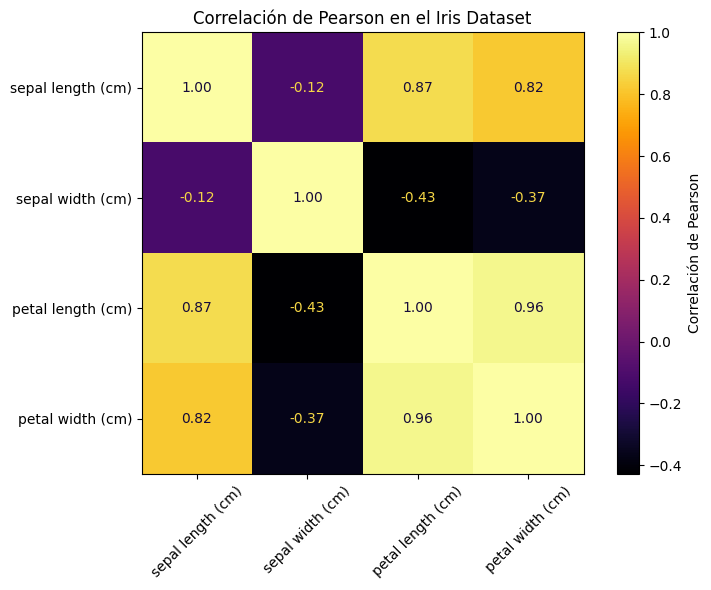

In [ ]:
# Calcular la correlación de Pearson
mat_corr = np.corrcoef(X, rowvar=False)

# Crear mapa de calor
plt.figure(figsize=(8, 6))
plt.imshow(mat_corr, cmap=cmap, interpolation='nearest')
plt.colorbar(label='Correlación de Pearson')
plt.xticks(np.arange(len(attrs)), attrs, rotation=45)
plt.yticks(np.arange(len(attrs)), attrs)
plt.title('Correlación de Pearson en el Iris Dataset')

# Agregar valores a casillas
for i in range(len(iris.feature_names)):
    for j in range(len(iris.feature_names)):
        color = cmap(0.1) if mat_corr[i, j] > -0.1 \
                else  cmap(0.9)
        plt.text(j, i, f'{mat_corr[i, j]:.2f}', ha='center',
                 va='center', color=color)
plt.tight_layout()
plt.show()

### Normalizar los datos

In [ ]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
scaler.fit(X)
X_norm = scaler.transform(X)

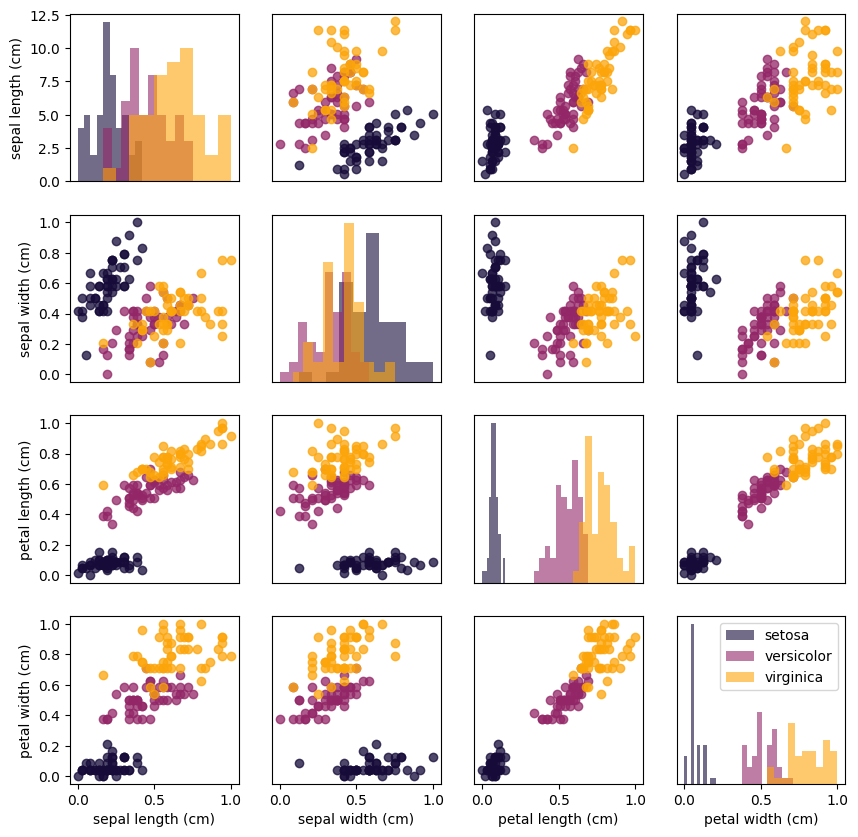

In [ ]:
# Crear figura
fig, axes = plt.subplots(nrows=num_attrs, ncols=num_attrs, figsize=(10, 10))

# Crear cada subfigura
for i in range(num_attrs):
    for j in range(num_attrs):
        ax = axes[i, j]

        if i == j:
            # Histograma sobre la diagonal. Mismo atributo
            for clss, mask, color, name in zip(classes, masks, color_class,
                                         classes_names):
                ax.hist(X_norm[mask, i], bins=10, color=color, alpha=0.6,
                        label=f'{name}')
        else:
            # Gráfica de dispersion en comparación de atributos
            for clss, mask, color, name in zip(classes, masks, color_class,
                                         classes_names):
                ax.scatter(X_norm[mask, j], X_norm[mask, i],
                           color=color, alpha=0.75, label=f'{name}')

        # No poner etiquetas a los ejes, excepto en las orillas
        if i < num_attrs - 1:
            ax.set_xticks([])
        if j > 0:
            ax.set_yticks([])


        # Poner etiquetas en las orillas
        if i == num_attrs - 1:
            ax.set_xlabel(f'{attrs[j]}')
        if j == 0:
            ax.set_ylabel(f'{attrs[i]}')
ax.legend()

plt.show()

Mediana sepal length. Setosa: 0.194 Versicolor: 0.444 Virgninica: 0.611
Mediana sepal width. Setosa: 0.583 Versicolor: 0.333 Virgninica: 0.417
Mediana petal length. Setosa: 0.085 Versicolor: 0.568 Virgninica: 0.771
Mediana slepal width. Setosa: 0.042 Versicolor: 0.500 Virgninica: 0.792


<Figure size 1000x600 with 0 Axes>

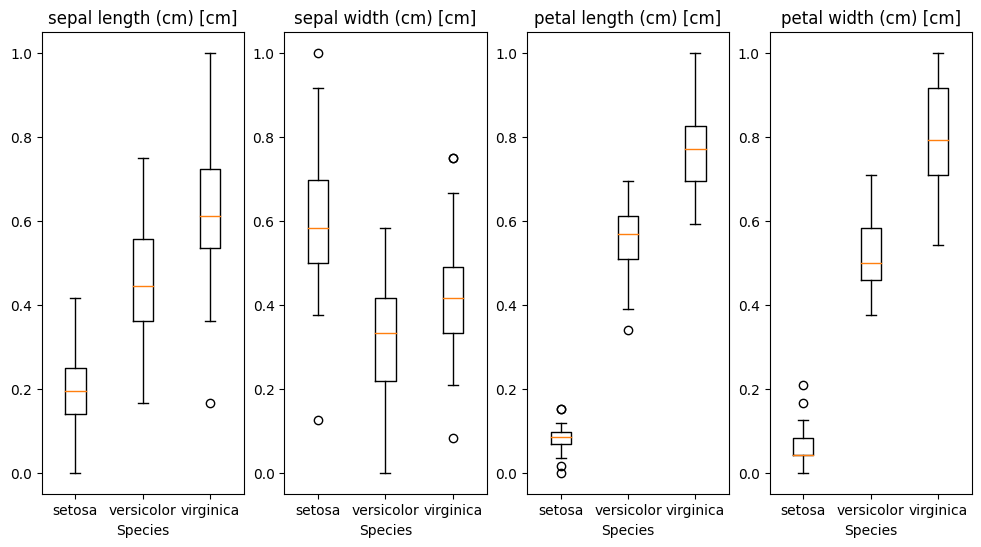

In [ ]:
# Crear gráficas tipo Boxplot
plt.figure(figsize=(10, 6))

fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(12, 6))

for idx, attr in enumerate(attrs):
    axes[idx].boxplot([X_norm[mask_0, idx], X_norm[mask_1, idx],
                       X_norm[mask_2, idx]])
    axes[idx].set_xticks([1, 2, 3], classes_names)
    axes[idx].set_title(f'{attr} [cm]')
    axes[idx].set_xlabel('Species')

sepal_length_median = np.array((np.median(X_norm[mask_0, 0]),
                                np.median(X_norm[mask_1, 0]),
                                np.median(X_norm[mask_2, 0])))

sepal_width_median = np.array((np.median(X_norm[mask_0, 1]),
                               np.median(X_norm[mask_1, 1]),
                               np.median(X_norm[mask_2, 1])))

petal_length_median = np.array((np.median(X_norm[mask_0, 2]),
                                np.median(X_norm[mask_1, 2]),
                                np.median(X_norm[mask_2, 2])))

petal_width_median = np.array((np.median(X_norm[mask_0, 3]),
                               np.median(X_norm[mask_1, 3]),
                               np.median(X_norm[mask_2, 3])))

print(f"Mediana sepal length. Setosa: {sepal_length_median[0]:.3f}"
      + f" Versicolor: {sepal_length_median[1]:.3f}"
      + f" Virgninica: {sepal_length_median[2]:.3f}")

print(f"Mediana sepal width. Setosa: {sepal_width_median[0]:.3f}"
      + f" Versicolor: {sepal_width_median[1]:.3f}"
      + f" Virgninica: {sepal_width_median[2]:.3f}")

print(f"Mediana petal length. Setosa: {petal_length_median[0]:.3f}"
      + f" Versicolor: {petal_length_median[1]:.3f}"
      + f" Virgninica: {petal_length_median[2]:.3f}")

print(f"Mediana slepal width. Setosa: {petal_width_median[0]:.3f}"
      + f" Versicolor: {petal_width_median[1]:.3f}"
      + f" Virgninica: {petal_width_median[2]:.3f}")

plt.show()


### Clasificación mediante algoritmo kNN
![](https://www.ibm.com/content/dam/connectedassets-adobe-cms/worldwide-content/cdp/cf/ul/g/ef/3a/KNN.component.complex-narrative-xl-retina.ts=1649769646428.png/content/adobe-cms/mx/es/topics/knn/jcr:content/root/table_of_contents/body/content_section_styled/content-section-body/complex_narrative/items/content_group/image)

In [ ]:
from sklearn.neighbors import KNeighborsClassifier

# partir entrenamiento y validacion
idx = np.arange(150)
print(idx)
np.random.shuffle(idx)  # desordenar patrones
print(idx)
X_norm = X_norm[idx, ...]
X = X[idx, ...]
y = y[idx]

X_train, y_train = X_norm[:30, ...], y[:30]
X_test, y_test = X_norm[30:, ...], y[30:]


[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149]
[ 73  18 118  78  76  31  64 141  68  82 110  12  36   9  19  56 104  69
  55 132  29 127  26 128 131 145 108 143  45  30  22  15  65  11  42 146
  51  27   4  32 142  85  86  16  10  81 133 137  75 109  96 105  66   0
 122  67  28  40  44  60 123  24  25  23  94  39  95 117  47  97 113  33
 138 101  62  84 148  53   5  93 111  49  35  80  77  34 114   7  43  70
  98 120  83 134 135  89 

In [ ]:
neigh = KNeighborsClassifier(n_neighbors=3)
neigh.fit(X_train, y_train)
y_pred = neigh.predict(X_test)

print(f"Accuracy del modelo con datos normalizados: {np.sum(y_pred == y_test) / y_test.shape[0]:.3f}")


# partir entrenamiento y validacion
X_train, y_train = X[:30, ...], y[:30]
X_test, y_test = X[30:, ...], y[30:]

neigh = KNeighborsClassifier(n_neighbors=5)
neigh.fit(X_train, y_train)
y_pred = neigh.predict(X_test)

print(f"Accuracy del modelo sin datos normalizados: {np.sum(y_pred == y_test) / y_test.shape[0]:.3f}")

Accuracy del modelo con datos normalizados: 0.942
Accuracy del modelo sin datos normalizados: 0.908
